# Satellite Images of Water Bodies

1. Dataset<br>
A collection of water bodies images captured by the Sentinel-2 Satellite. Each image comes with a black and white mask where white represents water and black represents something else but water.<br>
Data comes from Kaggle: https://www.kaggle.com/datasets/franciscoescobar/satellite-images-of-water-bodies

2. Project<br>
The goal of this project was to use a standard U-net implementation for image segmentation, more specifically, to train the network to recognize and locate bodies of water on the image.


In [2]:
import os
import numpy as np
from tqdm import tqdm
import cv2 as cv
from PIL import Image
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split

from keras import Model
from keras.callbacks import Callback
from keras.optimizers import Adam
from keras.utils import plot_model
from keras.layers import Input, Conv2D, Conv2DTranspose, MaxPooling2D, concatenate, Dropout

2024-12-17 16:04:56.068994: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-17 16:04:56.078166: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:477] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
E0000 00:00:1734480296.092291   11503 cuda_dnn.cc:8310] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
E0000 00:00:1734480296.095026   11503 cuda_blas.cc:1418] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-12-17 16:04:56.105153: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instr

In [10]:
image_path = 'test/Water Bodies Dataset.1/Images/'
mask_path = 'test/Water Bodies Dataset.1/Masks/'
SIZE = 128

In [15]:
# lists of images and masks names
image_names = sorted(next(os.walk(image_path))[-1])
mask_names = sorted(next(os.walk(mask_path))[-1])

images = np.zeros(shape=(len(image_names),SIZE, SIZE, 3))
masks = np.zeros(shape=(len(image_names),SIZE, SIZE, 1))

for id in tqdm(range(len(image_names)), desc="Images"):
  path = image_path + image_names[id]
  img = np.asarray(Image.open(path)).astype('float')/255.
  img = cv.resize(img, (SIZE,SIZE), cv.INTER_AREA)
  images[id] = img

for id in tqdm(range(len(mask_names)), desc="Mask"):
  path = mask_path + mask_names[id]
  mask = np.asarray(Image.open(path)).astype('float')/255.
  mask = cv.resize(mask, (SIZE,SIZE), cv.INTER_AREA)
  masks[id] = mask[:,:,:1]

Mask: 100%|██████████| 2912/2912 [00:18<00:00, 158.07it/s]


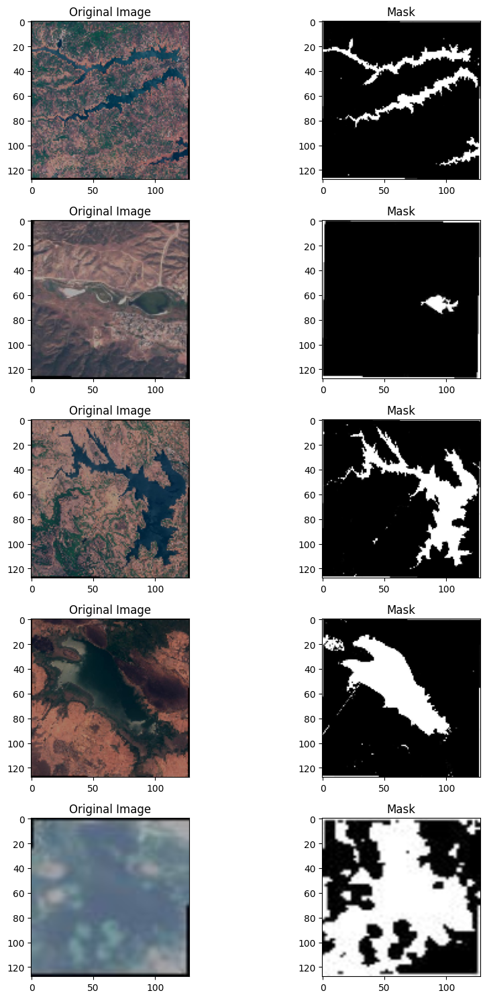

In [16]:
# Plot some images and its masks
plt.figure(figsize=(10,15))
for i in range(1,11):
  plt.subplot(5,2,i)

  if i%2!=0:
    id = np.random.randint(len(images))
    plt.imshow(images[id], cmap=None)
    plt.title('Original Image')
  elif i%2==0:
    plt.imshow(masks[id].reshape(128,128), cmap='gray')
    plt.title('Mask')

plt.tight_layout()
plt.show()

In [17]:
# Train test split
images_train, images_test, mask_train, mask_test = train_test_split(images, masks, test_size=0.01)

In [18]:
print(f'Train images: {len(images_train)}')
print(f'Test images: {len(images_test)}')

Train images: 2882
Test images: 30


In [19]:
# Define U-net architecture
def unet_model(input_layer, start_neurons):
    # Contraction path
    conv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(input_layer)
    conv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(conv1)
    pool1 = MaxPooling2D((2, 2))(conv1)
    pool1 = Dropout(0.25)(pool1)

    conv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(pool1)
    conv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(conv2)
    pool2 = MaxPooling2D((2, 2))(conv2)
    pool2 = Dropout(0.5)(pool2)

    conv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(pool2)
    conv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(conv3)
    pool3 = MaxPooling2D((2, 2))(conv3)
    pool3 = Dropout(0.5)(pool3)

    conv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(pool3)
    conv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(conv4)
    pool4 = MaxPooling2D((2, 2))(conv4)
    pool4 = Dropout(0.5)(pool4)

    # Middle
    convm = Conv2D(start_neurons*16, kernel_size=(3, 3), activation="relu", padding="same")(pool4)
    convm = Conv2D(start_neurons*16, kernel_size=(3, 3), activation="relu", padding="same")(convm)
    
    # Expansive path
    deconv4 = Conv2DTranspose(start_neurons*8, kernel_size=(3, 3), strides=(2, 2), padding="same")(convm)
    uconv4 = concatenate([deconv4, conv4])
    uconv4 = Dropout(0.5)(uconv4)
    uconv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(uconv4)
    uconv4 = Conv2D(start_neurons*8, kernel_size=(3, 3), activation="relu", padding="same")(uconv4)

    deconv3 = Conv2DTranspose(start_neurons*4, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv4)
    uconv3 = concatenate([deconv3, conv3])
    uconv3 = Dropout(0.5)(uconv3)
    uconv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(uconv3)
    uconv3 = Conv2D(start_neurons*4, kernel_size=(3, 3), activation="relu", padding="same")(uconv3)

    deconv2 = Conv2DTranspose(start_neurons*2, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv3)
    uconv2 = concatenate([deconv2, conv2])
    uconv2 = Dropout(0.5)(uconv2)
    uconv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(uconv2)
    uconv2 = Conv2D(start_neurons*2, kernel_size=(3, 3), activation="relu", padding="same")(uconv2)

    deconv1 = Conv2DTranspose(start_neurons*1, kernel_size=(3, 3), strides=(2, 2), padding="same")(uconv2)
    uconv1 = concatenate([deconv1, conv1])
    uconv1 = Dropout(0.5)(uconv1)
    uconv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(uconv1)
    uconv1 = Conv2D(start_neurons, kernel_size=(3, 3), activation="relu", padding="same")(uconv1)
    
    # Last conv and output
    output_layer = Conv2D(1, (1,1), padding="same", activation="sigmoid")(uconv1)
    
    return output_layer

In [20]:
# Compile unet model
input_layer = Input((SIZE, SIZE, 3))
output_layer = unet_model(input_layer = input_layer, start_neurons = 16)

model = Model(input_layer, output_layer)
model.compile(loss="binary_crossentropy", optimizer="adam", metrics=["accuracy"])
model.summary()

I0000 00:00:1734481013.463793   11503 gpu_device.cc:2022] Created device /job:localhost/replica:0/task:0/device:GPU:0 with 9367 MB memory:  -> device: 0, name: NVIDIA GeForce GTX 1080 Ti, pci bus id: 0000:01:00.0, compute capability: 6.1


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ input_layer         │ (None, 128, 128,  │          0 │ -                 │
│ (InputLayer)        │ 3)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d (Conv2D)     │ (None, 128, 128,  │        448 │ input_layer[0][0] │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_1 (Conv2D)   │ (None, 128, 128,  │      2,320 │ conv2d[0][0]      │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d       │ (None, 64, 64,    │          0 │ conv2d_1[0][0]    │
│ (MaxPooling2D)      │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout (Dropout)   │ (None, 64, 64,    │          0 │ max_pooling2d[0]… │
│                     │ 16)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_2 (Conv2D)   │ (None, 64, 64,    │      4,640 │ dropout[0][0]     │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_3 (Conv2D)   │ (None, 64, 64,    │      9,248 │ conv2d_2[0][0]    │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_1     │ (None, 32, 32,    │          0 │ conv2d_3[0][0]    │
│ (MaxPooling2D)      │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_1 (Dropout) │ (None, 32, 32,    │          0 │ max_pooling2d_1[… │
│                     │ 32)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_4 (Conv2D)   │ (None, 32, 32,    │     18,496 │ dropout_1[0][0]   │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_5 (Conv2D)   │ (None, 32, 32,    │     36,928 │ conv2d_4[0][0]    │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_2     │ (None, 16, 16,    │          0 │ conv2d_5[0][0]    │
│ (MaxPooling2D)      │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_2 (Dropout) │ (None, 16, 16,    │          0 │ max_pooling2d_2[… │
│                     │ 64)               │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_6 (Conv2D)   │ (None, 16, 16,    │     73,856 │ dropout_2[0][0]   │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ conv2d_7 (Conv2D)   │ (None, 16, 16,    │    147,584 │ conv2d_6[0][0]    │
│                     │ 128)              │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ max_pooling2d_3     │ (None, 8, 8, 128) │          0 │ conv2d_7[0][0]    │
│ (MaxPooling2D)      │                   │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ dropout_3 (Dropout) │ (None, 8, 8, 128) │          0 │ max_pooling2d_3[

 Total params: 2,158,705 (8.23 MB)

 Trainable params: 2,158,705 (8.23 MB)

 Non-trainable params: 0 (0.00 B)

In [21]:
# Post Process
def mask_threshold(image, threshold=0.25):
  return image>threshold

# Callback to show progress of learning on the images after each epoch
class ShowProgress(Callback):
  def __init__(self, save=False):
    self.save = save
  def on_epoch_end(self, epoch, logs=None):
    k = np.random.randint(len(images_train))
    original_image = images_train[k][np.newaxis,...]
    predicted_mask = self.model.predict(original_image).reshape(128,128)
    proc_mask02 = mask_threshold(predicted_mask, threshold=0.2)
    proc_mask03 = mask_threshold(predicted_mask, threshold=0.3)
    proc_mask04 = mask_threshold(predicted_mask, threshold=0.4)
    proc_mask05 = mask_threshold(predicted_mask, threshold=0.5)
    mask = mask_train[k].reshape(128,128)

    plt.figure(figsize=(15,10))

    plt.subplot(1,7,1)
    plt.imshow(original_image[0]);plt.title('Orginal Image')

    plt.subplot(1,7,2)
    plt.imshow(predicted_mask, cmap='gray');plt.title('Predicted Mask')
    
    plt.subplot(1,7,3)
    plt.imshow(mask, cmap='gray');plt.title('Orginal Mask')

    plt.subplot(1,7,4)
    plt.imshow(proc_mask02, cmap='gray');plt.title('Processed: 0.2')

    plt.subplot(1,7,5)
    plt.imshow(proc_mask03, cmap='gray');plt.title('Processed: 0.3')

    plt.subplot(1,7,6)
    plt.imshow(proc_mask04, cmap='gray');plt.title('Processed: 0.4')

    plt.subplot(1,7,6)
    plt.imshow(proc_mask05, cmap='gray');plt.title('Processed: 0.5')

    plt.tight_layout()
    plt.show()

Epoch 1/100


I0000 00:00:1734481022.939994   12482 service.cc:148] XLA service 0x7f3130009100 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
I0000 00:00:1734481022.940260   12482 service.cc:156]   StreamExecutor device (0): NVIDIA GeForce GTX 1080 Ti, Compute Capability 6.1
2024-12-17 16:17:03.033537: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
I0000 00:00:1734481023.403033   12482 cuda_dnn.cc:529] Loaded cuDNN version 90300
2024-12-17 16:17:04.153913: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[32,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[32,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_con

 3/91 ━━━━━━━━━━━━━━━━━━━━ 3s 44ms/step - accuracy: 0.3672 - loss: 0.6938 

2024-12-17 16:17:12.720188: I external/local_xla/xla/stream_executor/cuda/cuda_asm_compiler.cc:397] ptxas warning : Registers are spilled to local memory in function 'input_transpose_fusion_4', 8 bytes spill stores, 8 bytes spill loads
ptxas warning : Registers are spilled to local memory in function 'input_transpose_fusion', 8 bytes spill stores, 8 bytes spill loads

I0000 00:00:1734481032.756349   12482 device_compiler.h:188] Compiled cluster using XLA!  This line is logged at most once for the lifetime of the process.


88/91 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - accuracy: 0.5387 - loss: 0.6060

2024-12-17 16:17:17.266337: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[2,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[2,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kNone","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]}
2024-12-17 16:17:17.297214: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[2,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[2,16,128,128]{3,2,1,0}, f32[16,16,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward

91/91 ━━━━━━━━━━━━━━━━━━━━ 0s 106ms/step - accuracy: 0.5396 - loss: 0.6050

2024-12-17 16:17:22.664015: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[30,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[30,3,128,128]{3,2,1,0}, f32[16,3,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kRelu","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]}
2024-12-17 16:17:22.680421: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[30,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[30,16,128,128]{3,2,1,0}, f32[16,16,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationFor

1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 804ms/step


2024-12-17 16:17:24.981067: I external/local_xla/xla/service/gpu/autotuning/conv_algorithm_picker.cc:557] Omitted potentially buggy algorithm eng14{} for conv (f32[1,16,128,128]{3,2,1,0}, u8[0]{0}) custom-call(f32[1,32,128,128]{3,2,1,0}, f32[16,32,3,3]{3,2,1,0}, f32[16]{0}), window={size=3x3 pad=1_1x1_1}, dim_labels=bf01_oi01->bf01, custom_call_target="__cudnn$convBiasActivationForward", backend_config={"cudnn_conv_backend_config":{"activation_mode":"kRelu","conv_result_scale":1,"leakyrelu_alpha":0,"side_input_scale":0},"force_earliest_schedule":false,"operation_queue_id":"0","wait_on_operation_queues":[]}


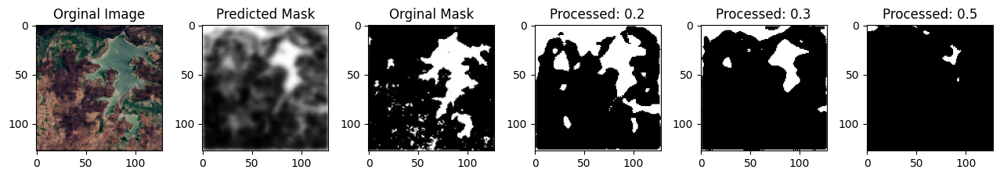

91/91 ━━━━━━━━━━━━━━━━━━━━ 25s 140ms/step - accuracy: 0.5399 - loss: 0.6046 - val_accuracy: 0.6466 - val_loss: 0.5097
Epoch 2/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.6534 - loss: 0.49


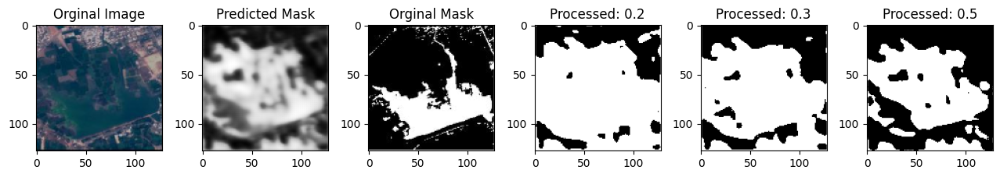

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6534 - loss: 0.4964 - val_accuracy: 0.6655 - val_loss: 0.4665
Epoch 3/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.6501 - loss: 0.451


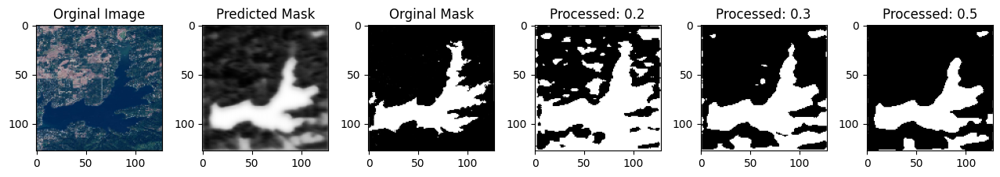

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.6505 - loss: 0.4512 - val_accuracy: 0.6653 - val_loss: 0.4602
Epoch 4/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.6730 - loss: 0.424


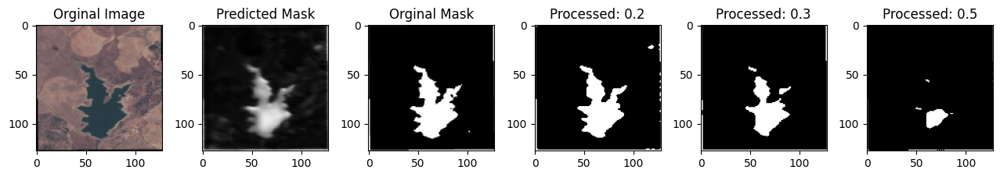

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6733 - loss: 0.4242 - val_accuracy: 0.6301 - val_loss: 0.4967
Epoch 5/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.6668 - loss: 0.434


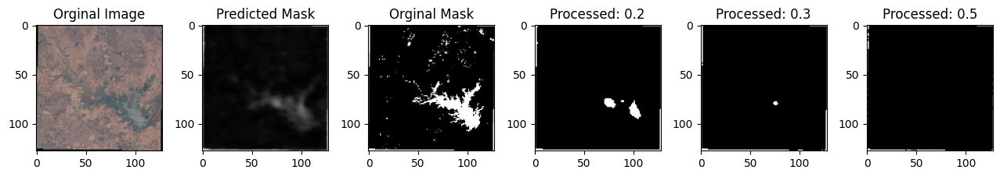

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6671 - loss: 0.4336 - val_accuracy: 0.7128 - val_loss: 0.3846
Epoch 6/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.6951 - loss: 0.377


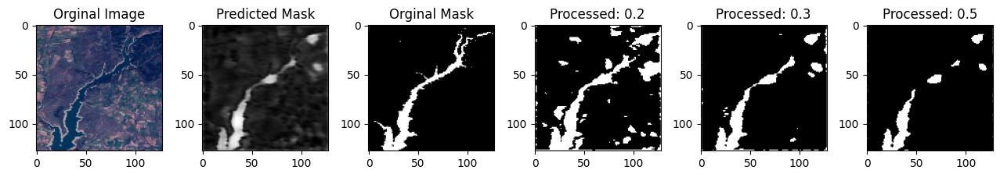

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.6951 - loss: 0.3774 - val_accuracy: 0.6950 - val_loss: 0.3971
Epoch 7/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.6910 - loss: 0.383


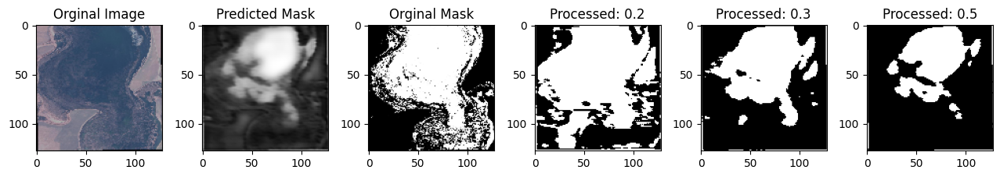

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6910 - loss: 0.3837 - val_accuracy: 0.6997 - val_loss: 0.4020
Epoch 8/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.6894 - loss: 0.380


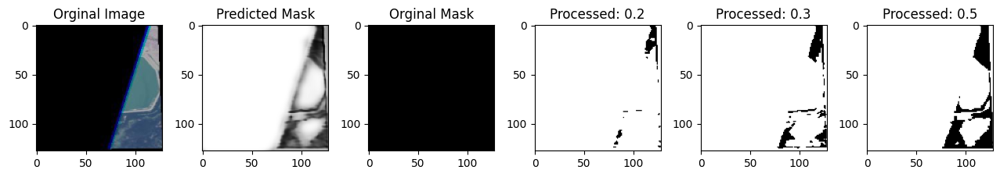

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.6896 - loss: 0.3805 - val_accuracy: 0.7065 - val_loss: 0.3711
Epoch 9/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.6954 - loss: 0.366


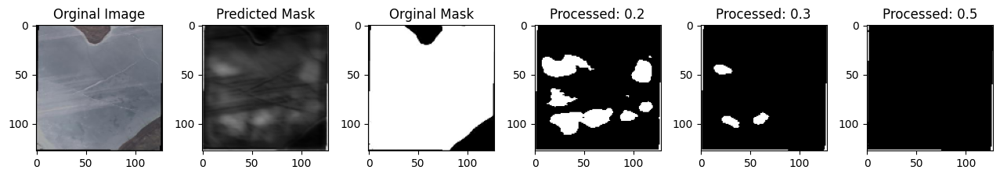

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.6956 - loss: 0.3656 - val_accuracy: 0.7169 - val_loss: 0.3535
Epoch 10/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.6881 - loss: 0.380


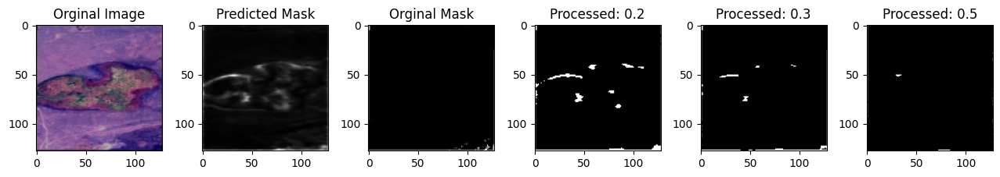

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6882 - loss: 0.3804 - val_accuracy: 0.7216 - val_loss: 0.3364
Epoch 11/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7038 - loss: 0.348


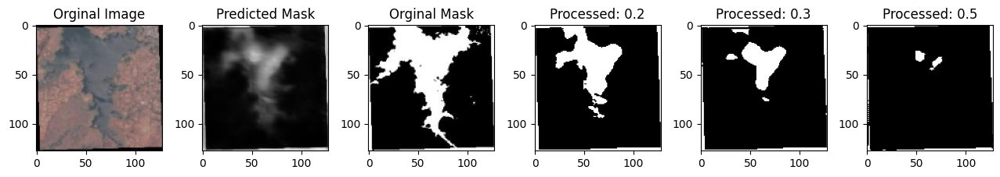

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7038 - loss: 0.3481 - val_accuracy: 0.7236 - val_loss: 0.3312
Epoch 12/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7070 - loss: 0.344


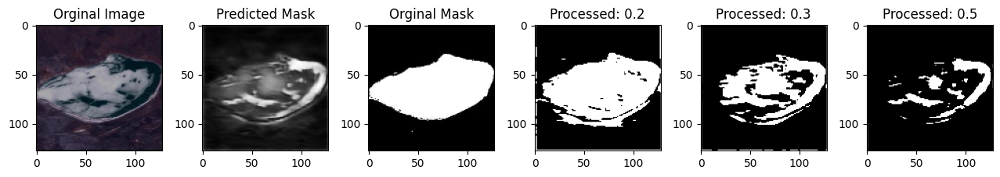

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7070 - loss: 0.3445 - val_accuracy: 0.7253 - val_loss: 0.3303
Epoch 13/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7019 - loss: 0.348


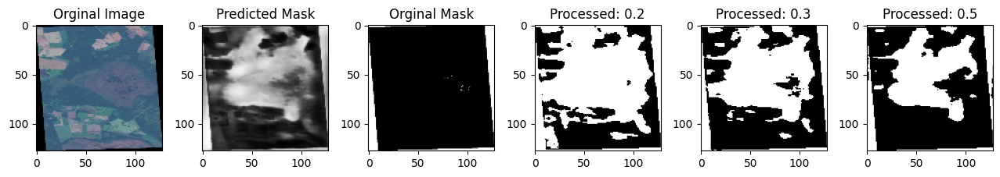

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7020 - loss: 0.3480 - val_accuracy: 0.7240 - val_loss: 0.3250
Epoch 14/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7124 - loss: 0.335


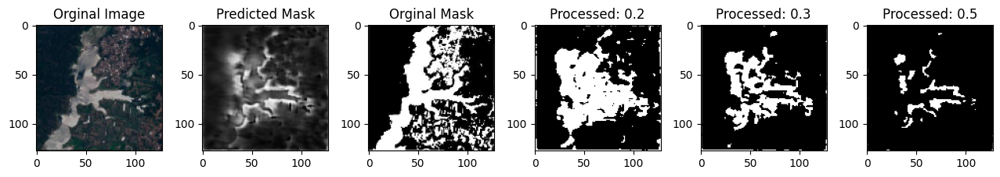

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7124 - loss: 0.3357 - val_accuracy: 0.7247 - val_loss: 0.3344
Epoch 15/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7152 - loss: 0.325


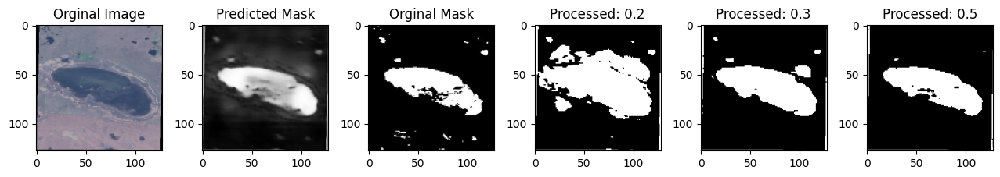

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.7151 - loss: 0.3253 - val_accuracy: 0.7239 - val_loss: 0.3349
Epoch 16/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7112 - loss: 0.321


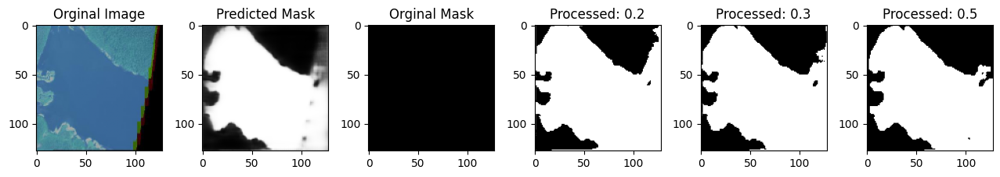

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7113 - loss: 0.3216 - val_accuracy: 0.7135 - val_loss: 0.3607
Epoch 17/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7112 - loss: 0.329


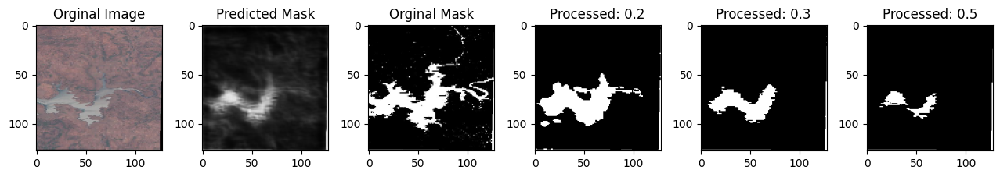

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7112 - loss: 0.3294 - val_accuracy: 0.7211 - val_loss: 0.3369
Epoch 18/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7177 - loss: 0.321


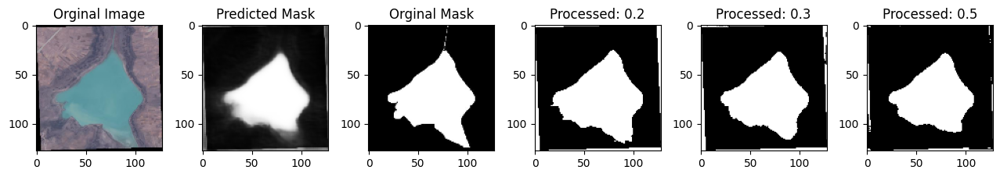

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7176 - loss: 0.3211 - val_accuracy: 0.7293 - val_loss: 0.3208
Epoch 19/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7144 - loss: 0.321


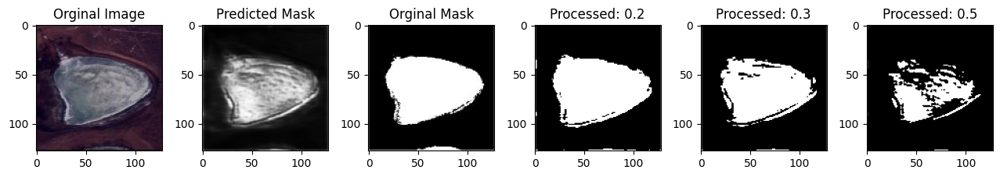

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7144 - loss: 0.3212 - val_accuracy: 0.7366 - val_loss: 0.2941
Epoch 20/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7151 - loss: 0.311


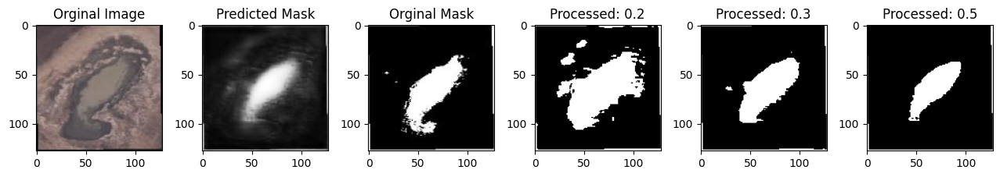

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7151 - loss: 0.3117 - val_accuracy: 0.7307 - val_loss: 0.3152
Epoch 21/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7243 - loss: 0.295


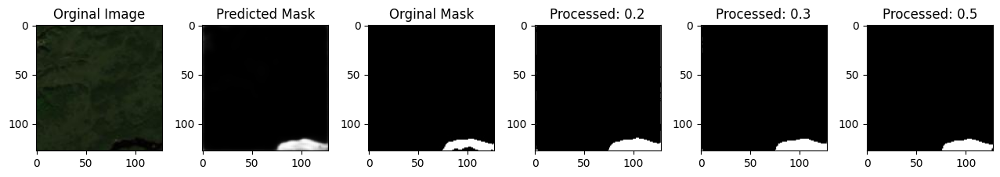

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7243 - loss: 0.2956 - val_accuracy: 0.7235 - val_loss: 0.3476
Epoch 22/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7103 - loss: 0.329


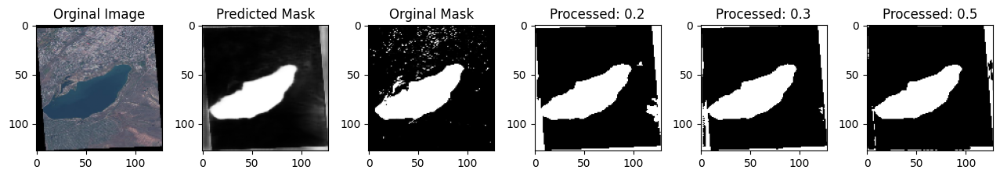

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7103 - loss: 0.3290 - val_accuracy: 0.7384 - val_loss: 0.2747
Epoch 23/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7224 - loss: 0.302


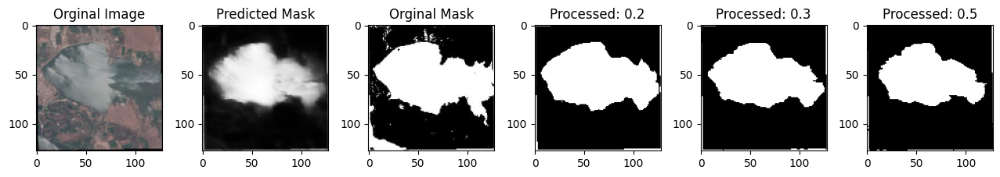

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.7224 - loss: 0.3026 - val_accuracy: 0.7503 - val_loss: 0.2580
Epoch 24/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7273 - loss: 0.289


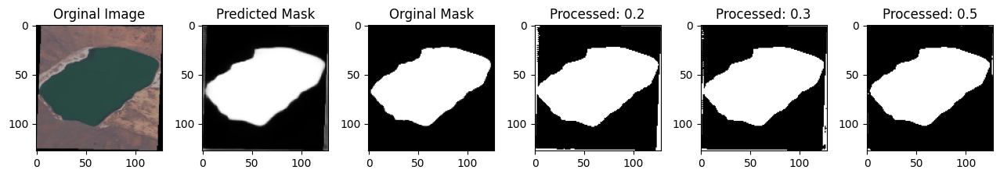

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7273 - loss: 0.2891 - val_accuracy: 0.7557 - val_loss: 0.2485
Epoch 25/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7215 - loss: 0.303


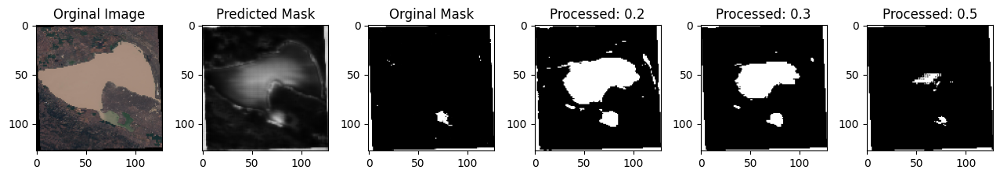

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7216 - loss: 0.3035 - val_accuracy: 0.7448 - val_loss: 0.2434
Epoch 26/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7210 - loss: 0.31


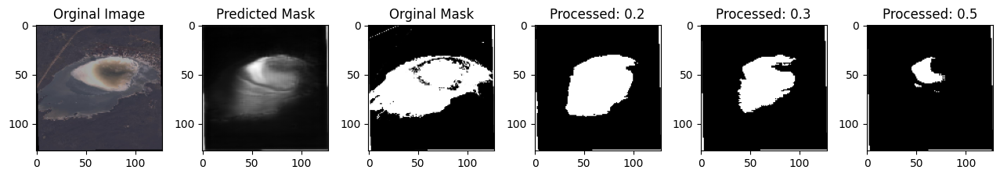

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7210 - loss: 0.3105 - val_accuracy: 0.7318 - val_loss: 0.3131
Epoch 27/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/stepep - accuracy: 0.7114 - loss: 0.417


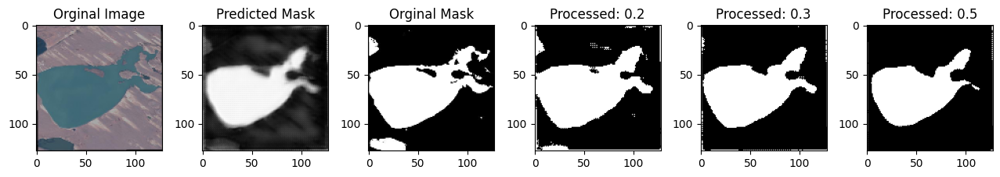

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7106 - loss: 0.4217 - val_accuracy: 0.6824 - val_loss: 0.4663
Epoch 28/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.6630 - loss: 0.456


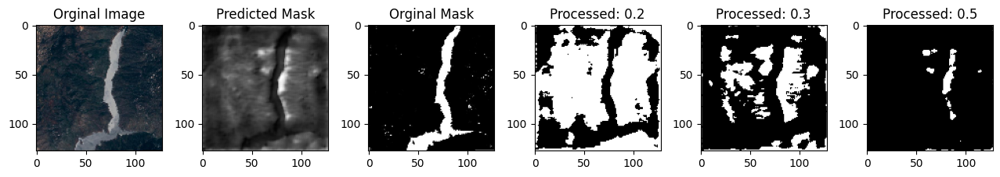

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6631 - loss: 0.4561 - val_accuracy: 0.7044 - val_loss: 0.4039
Epoch 29/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.6826 - loss: 0.414


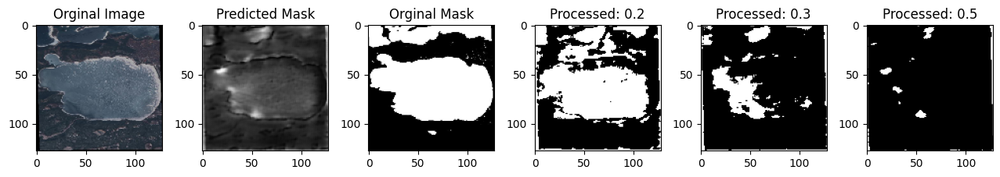

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6826 - loss: 0.4144 - val_accuracy: 0.7082 - val_loss: 0.3804
Epoch 30/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.6945 - loss: 0.38


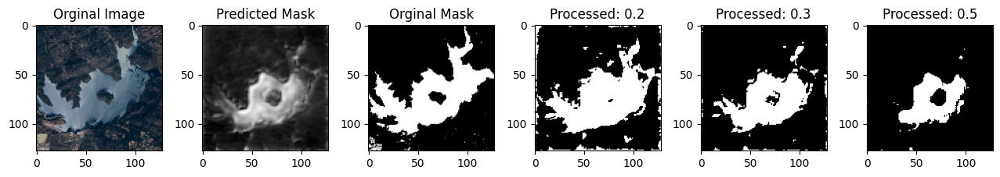

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6945 - loss: 0.3815 - val_accuracy: 0.7184 - val_loss: 0.3551
Epoch 31/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7053 - loss: 0.357


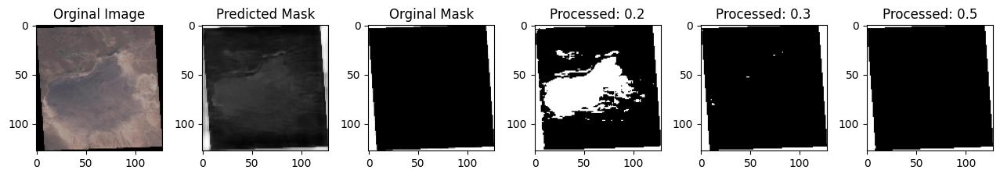

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7053 - loss: 0.3575 - val_accuracy: 0.7212 - val_loss: 0.3319
Epoch 32/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7094 - loss: 0.345


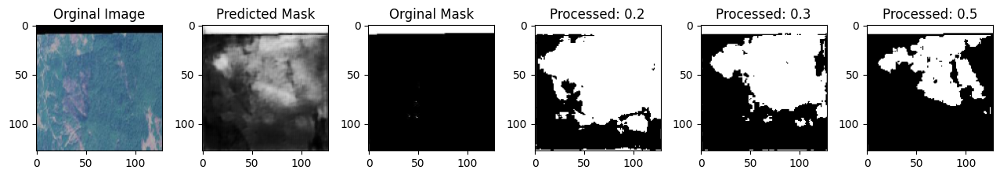

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.7094 - loss: 0.3454 - val_accuracy: 0.7243 - val_loss: 0.3339
Epoch 33/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 14ms/stepep - accuracy: 0.7061 - loss: 0.339


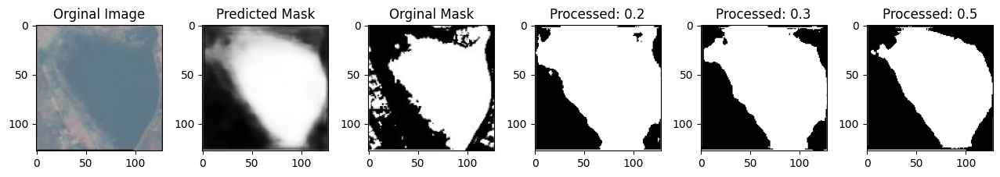

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7062 - loss: 0.3391 - val_accuracy: 0.7253 - val_loss: 0.3045
Epoch 34/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7197 - loss: 0.316


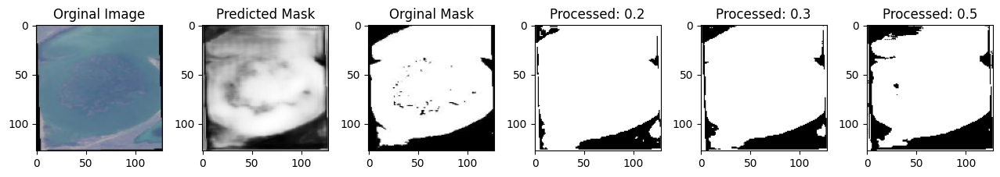

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7195 - loss: 0.3165 - val_accuracy: 0.7261 - val_loss: 0.3026
Epoch 35/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7141 - loss: 0.329


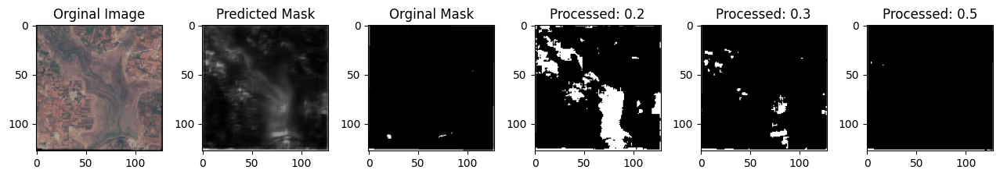

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7141 - loss: 0.3293 - val_accuracy: 0.7332 - val_loss: 0.2878
Epoch 36/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7243 - loss: 0.306


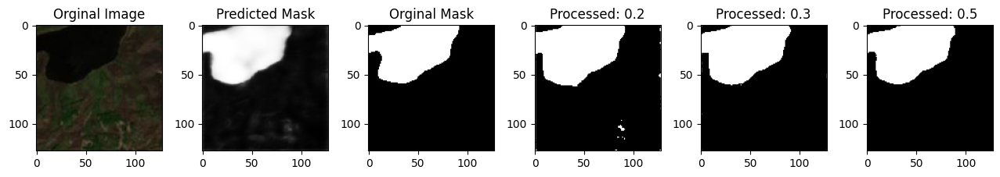

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7243 - loss: 0.3069 - val_accuracy: 0.7277 - val_loss: 0.3079
Epoch 37/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7286 - loss: 0.291


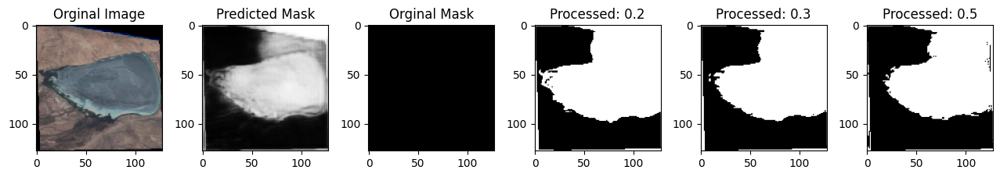

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7286 - loss: 0.2916 - val_accuracy: 0.7527 - val_loss: 0.2492
Epoch 38/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7234 - loss: 0.298


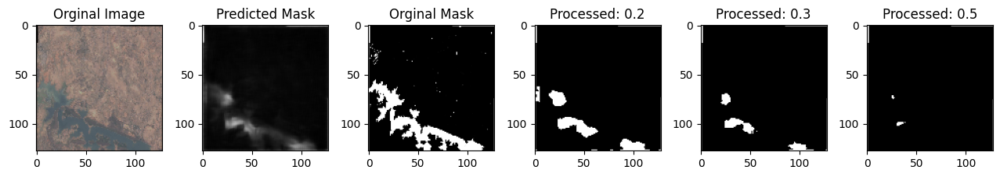

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7234 - loss: 0.2987 - val_accuracy: 0.7494 - val_loss: 0.2507
Epoch 39/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7180 - loss: 0.305


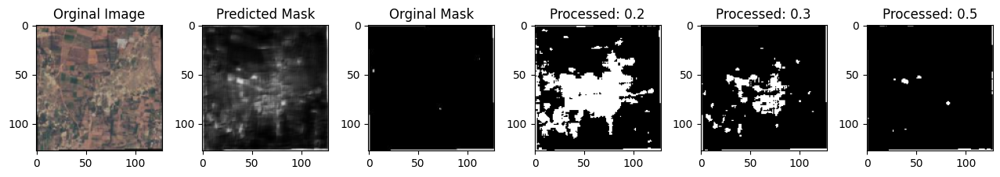

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7182 - loss: 0.3048 - val_accuracy: 0.7581 - val_loss: 0.2405
Epoch 40/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7283 - loss: 0.290


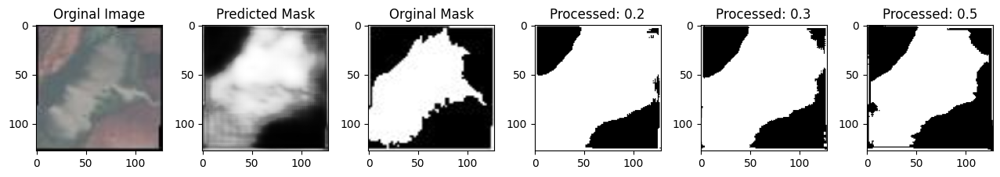

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7283 - loss: 0.2899 - val_accuracy: 0.7570 - val_loss: 0.2429
Epoch 41/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7265 - loss: 0.28


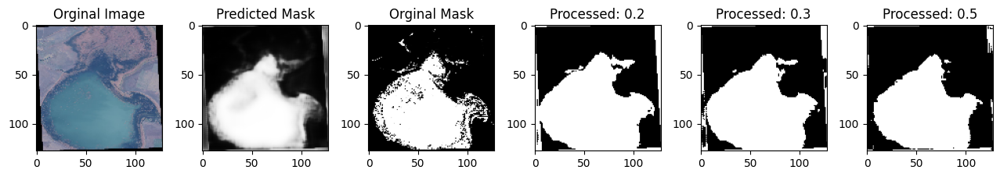

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.7264 - loss: 0.2850 - val_accuracy: 0.7513 - val_loss: 0.2495
Epoch 42/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7376 - loss: 0.280


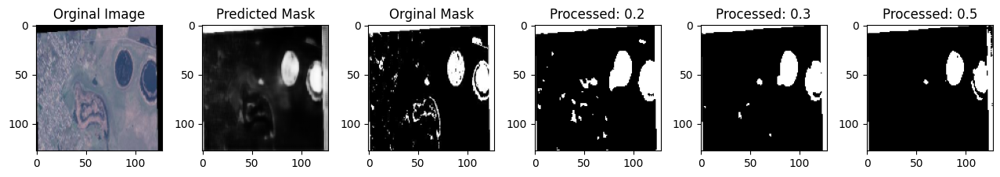

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7373 - loss: 0.2806 - val_accuracy: 0.7553 - val_loss: 0.2383
Epoch 43/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7260 - loss: 0.355


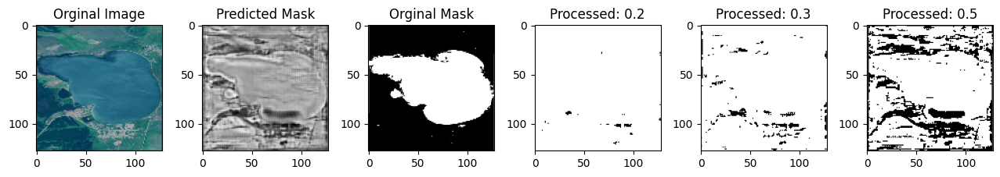

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7258 - loss: 0.3593 - val_accuracy: 0.6076 - val_loss: 0.5414
Epoch 44/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.5950 - loss: 0.526


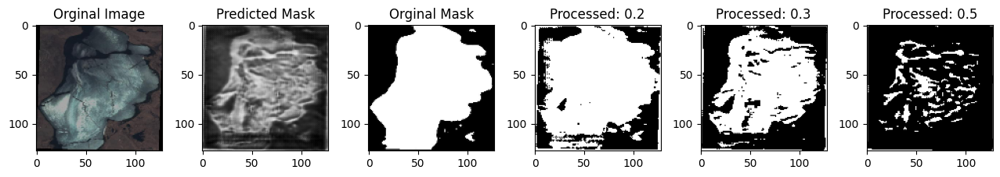

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.5954 - loss: 0.5262 - val_accuracy: 0.6607 - val_loss: 0.4652
Epoch 45/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.6224 - loss: 0.488


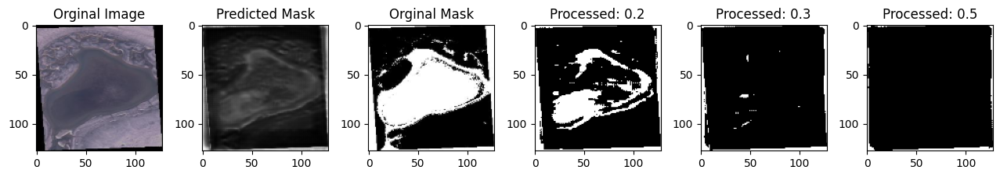

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6227 - loss: 0.4880 - val_accuracy: 0.6858 - val_loss: 0.4219
Epoch 46/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.6599 - loss: 0.438


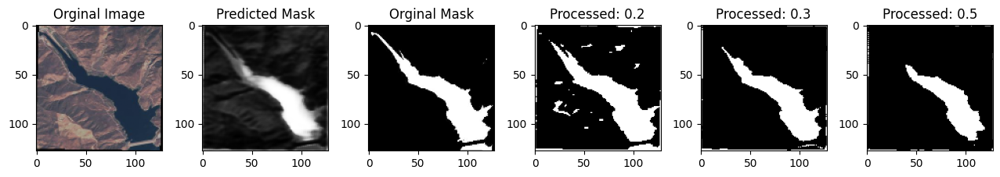

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6600 - loss: 0.4388 - val_accuracy: 0.6612 - val_loss: 0.4527
Epoch 47/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.6836 - loss: 0.409


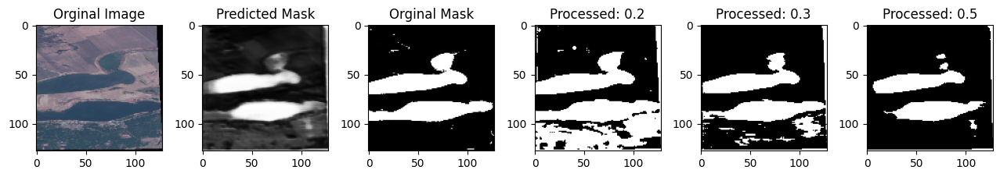

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6836 - loss: 0.4094 - val_accuracy: 0.7119 - val_loss: 0.3816
Epoch 48/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.6856 - loss: 0.407


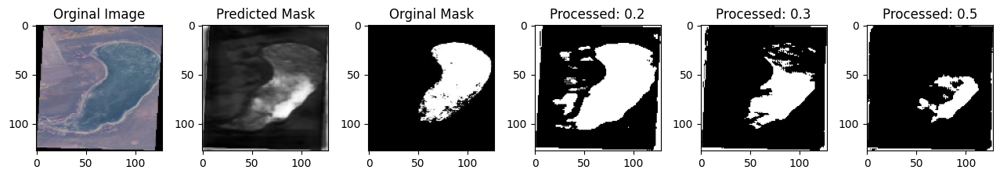

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6857 - loss: 0.4072 - val_accuracy: 0.7078 - val_loss: 0.3837
Epoch 49/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.6951 - loss: 0.386


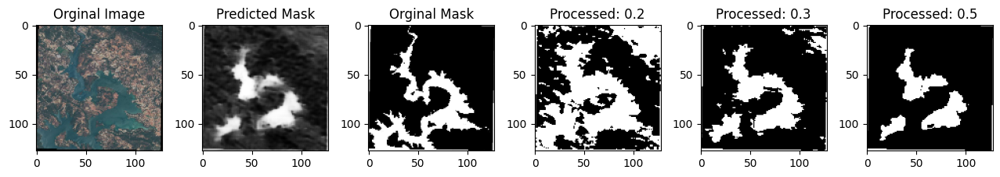

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.6951 - loss: 0.3861 - val_accuracy: 0.7047 - val_loss: 0.3897
Epoch 50/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.6950 - loss: 0.382


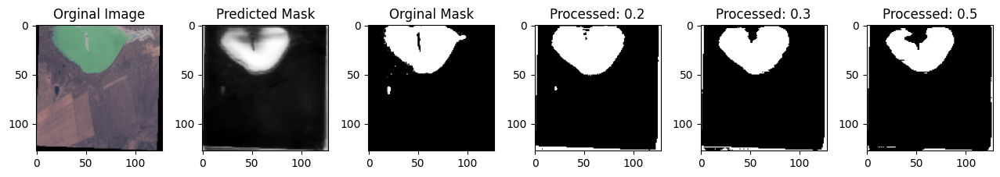

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.6951 - loss: 0.3822 - val_accuracy: 0.7217 - val_loss: 0.3483
Epoch 51/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7010 - loss: 0.361


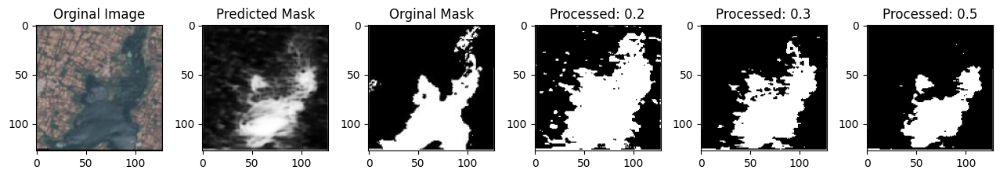

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7012 - loss: 0.3612 - val_accuracy: 0.7218 - val_loss: 0.3411
Epoch 52/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7111 - loss: 0.347


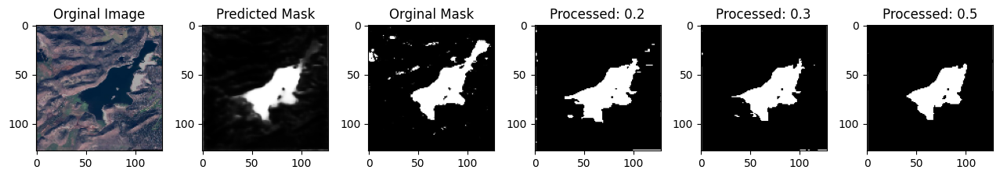

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7111 - loss: 0.3472 - val_accuracy: 0.7272 - val_loss: 0.3313
Epoch 53/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7139 - loss: 0.335


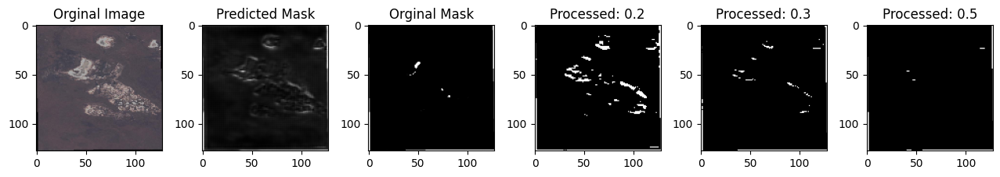

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7139 - loss: 0.3353 - val_accuracy: 0.7309 - val_loss: 0.3149
Epoch 54/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7141 - loss: 0.332


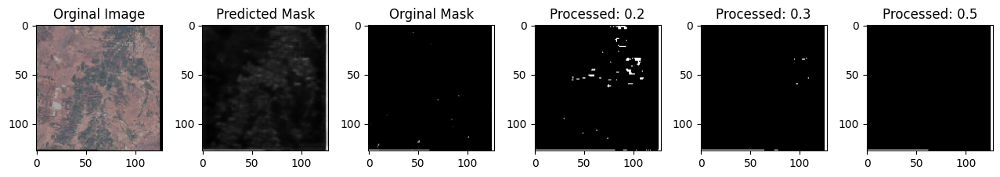

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7141 - loss: 0.3322 - val_accuracy: 0.7286 - val_loss: 0.3157
Epoch 55/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7211 - loss: 0.311


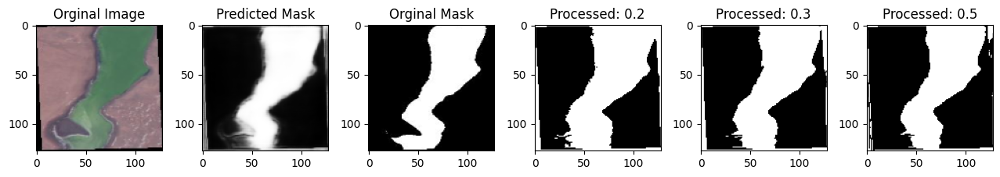

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7211 - loss: 0.3111 - val_accuracy: 0.7292 - val_loss: 0.3108
Epoch 56/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7178 - loss: 0.309


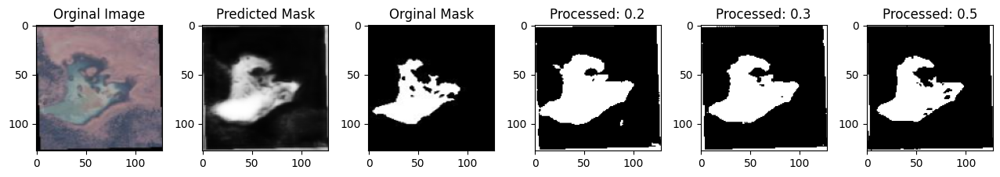

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7179 - loss: 0.3089 - val_accuracy: 0.7407 - val_loss: 0.2765
Epoch 57/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7283 - loss: 0.302


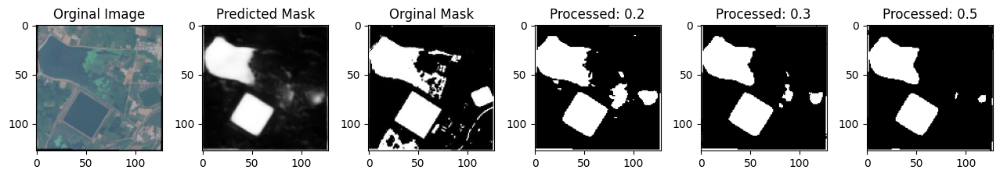

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7283 - loss: 0.3024 - val_accuracy: 0.7427 - val_loss: 0.2617
Epoch 58/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7251 - loss: 0.297


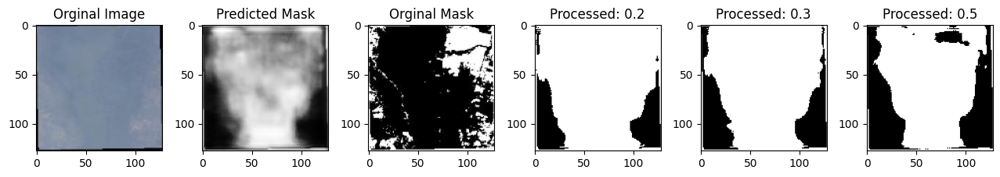

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7252 - loss: 0.2974 - val_accuracy: 0.7411 - val_loss: 0.2785
Epoch 59/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/stepep - accuracy: 0.7291 - loss: 0.296


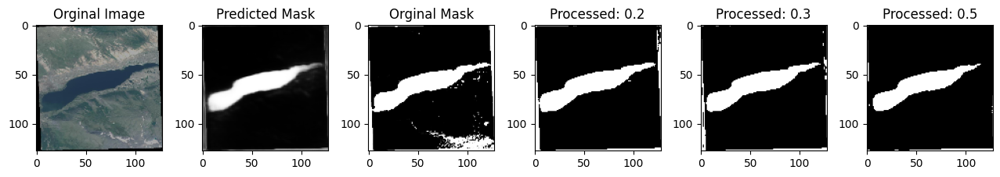

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.7291 - loss: 0.2969 - val_accuracy: 0.7471 - val_loss: 0.2623
Epoch 60/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 15ms/stepep - accuracy: 0.7302 - loss: 0.282


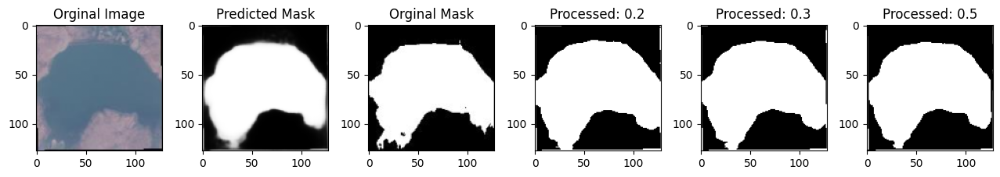

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7301 - loss: 0.2830 - val_accuracy: 0.7459 - val_loss: 0.2632
Epoch 61/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7295 - loss: 0.30


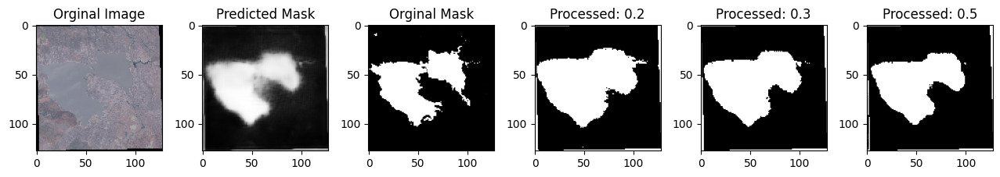

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7295 - loss: 0.3007 - val_accuracy: 0.7526 - val_loss: 0.2512
Epoch 62/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7286 - loss: 0.286


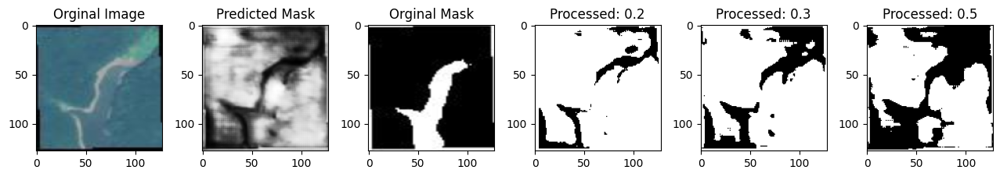

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7285 - loss: 0.2870 - val_accuracy: 0.7422 - val_loss: 0.2614
Epoch 63/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7314 - loss: 0.283


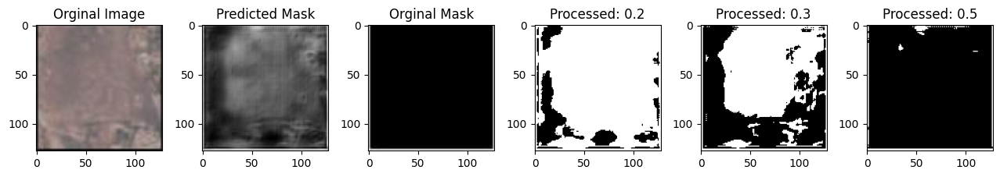

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7314 - loss: 0.2835 - val_accuracy: 0.7510 - val_loss: 0.2628
Epoch 64/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7251 - loss: 0.29


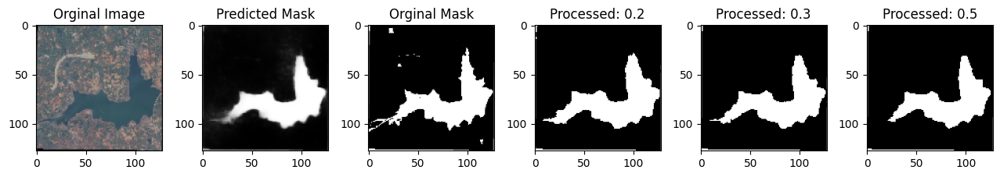

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7251 - loss: 0.2947 - val_accuracy: 0.7577 - val_loss: 0.2322
Epoch 65/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7374 - loss: 0.275


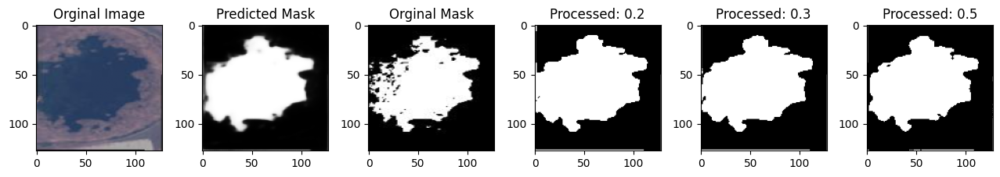

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7373 - loss: 0.2751 - val_accuracy: 0.7533 - val_loss: 0.2372
Epoch 66/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7270 - loss: 0.281


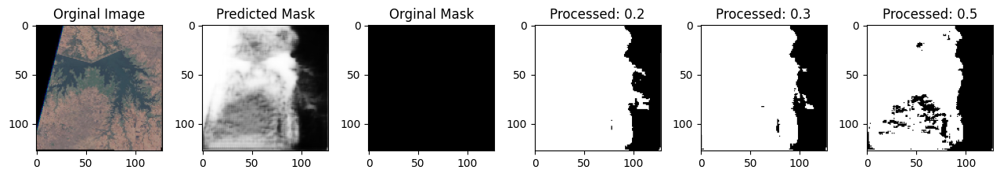

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7270 - loss: 0.2810 - val_accuracy: 0.7576 - val_loss: 0.2305
Epoch 67/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7329 - loss: 0.276


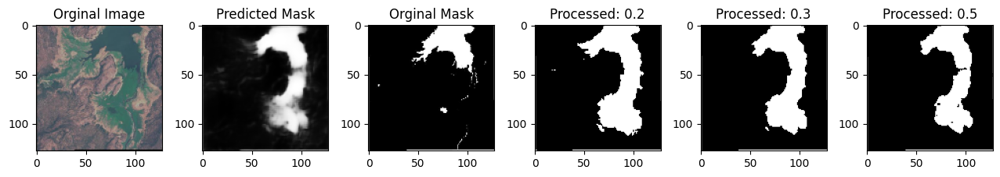

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 49ms/step - accuracy: 0.7329 - loss: 0.2764 - val_accuracy: 0.7552 - val_loss: 0.2371
Epoch 68/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7370 - loss: 0.265


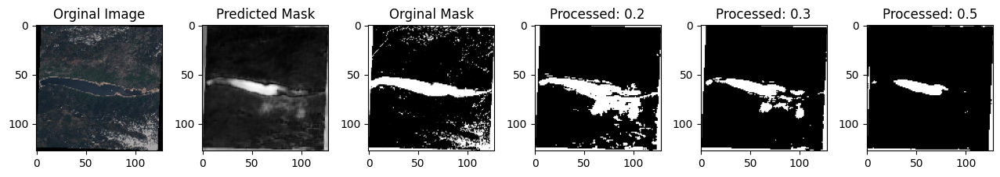

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7370 - loss: 0.2652 - val_accuracy: 0.7551 - val_loss: 0.2333
Epoch 69/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7354 - loss: 0.267


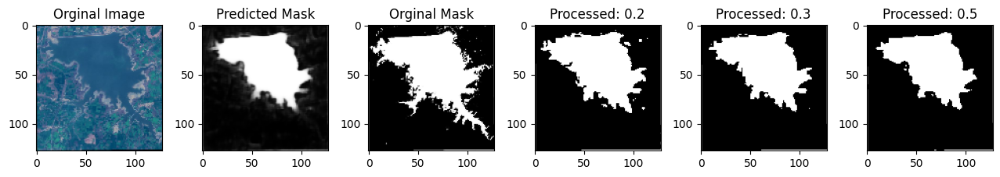

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7354 - loss: 0.2675 - val_accuracy: 0.7554 - val_loss: 0.2480
Epoch 70/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7361 - loss: 0.270


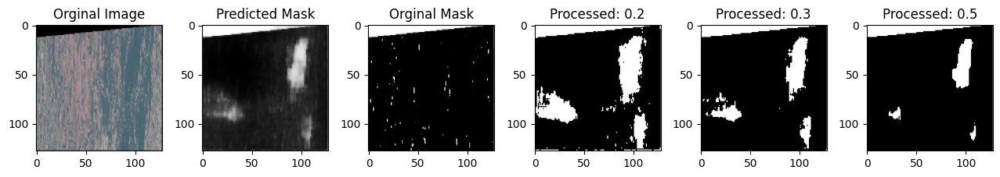

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7361 - loss: 0.2702 - val_accuracy: 0.7572 - val_loss: 0.2306
Epoch 71/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7303 - loss: 0.27


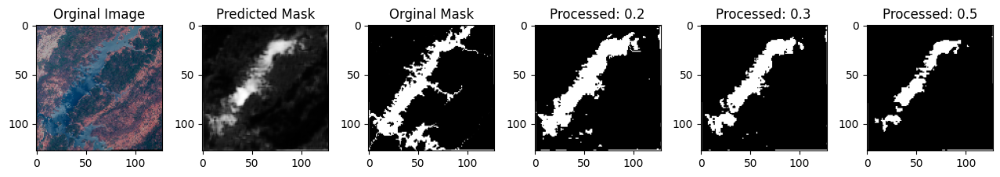

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7305 - loss: 0.2699 - val_accuracy: 0.7598 - val_loss: 0.2276
Epoch 72/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7398 - loss: 0.259


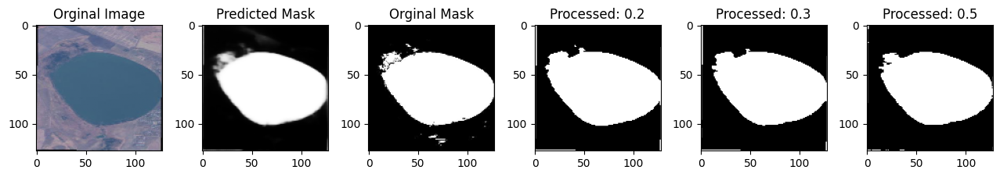

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7398 - loss: 0.2600 - val_accuracy: 0.7515 - val_loss: 0.2529
Epoch 73/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7407 - loss: 0.271


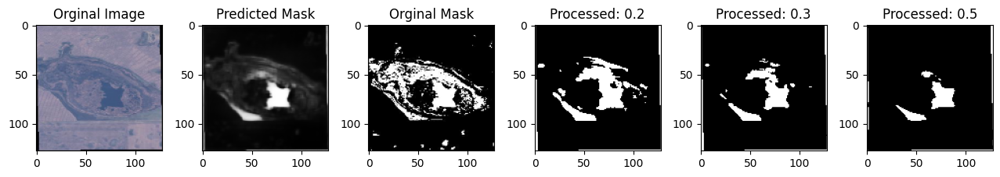

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7407 - loss: 0.2719 - val_accuracy: 0.7587 - val_loss: 0.2365
Epoch 74/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7356 - loss: 0.258


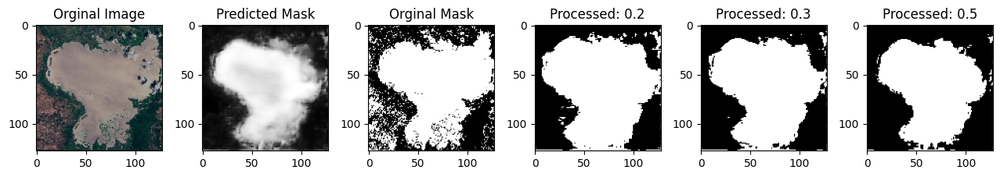

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 44ms/step - accuracy: 0.7357 - loss: 0.2585 - val_accuracy: 0.7563 - val_loss: 0.2361
Epoch 75/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7358 - loss: 0.264


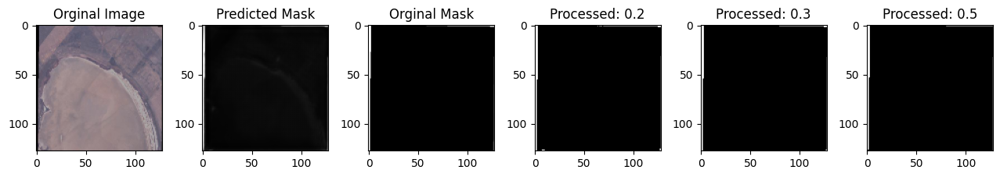

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7358 - loss: 0.2647 - val_accuracy: 0.7446 - val_loss: 0.3029
Epoch 76/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7351 - loss: 0.26


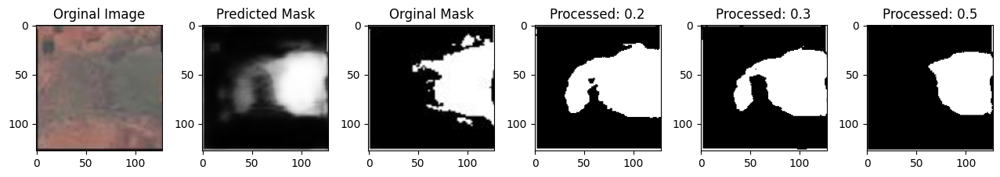

91/91 ━━━━━━━━━━━━━━━━━━━━ 5s 49ms/step - accuracy: 0.7351 - loss: 0.2680 - val_accuracy: 0.7535 - val_loss: 0.2376
Epoch 77/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7393 - loss: 0.26


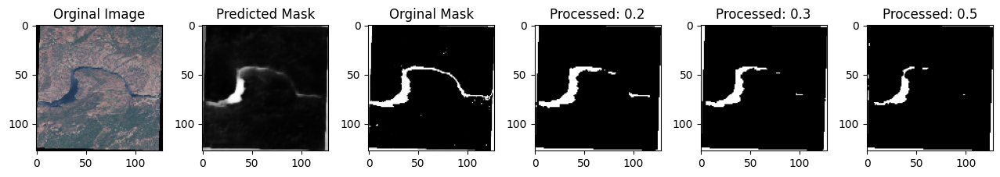

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7392 - loss: 0.2622 - val_accuracy: 0.7638 - val_loss: 0.2186
Epoch 78/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/stepep - accuracy: 0.7379 - loss: 0.260


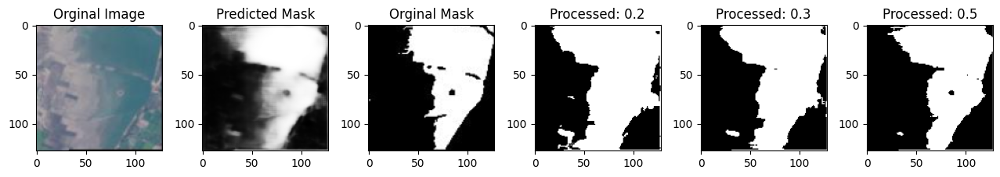

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7379 - loss: 0.2602 - val_accuracy: 0.7619 - val_loss: 0.2246
Epoch 79/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7372 - loss: 0.26


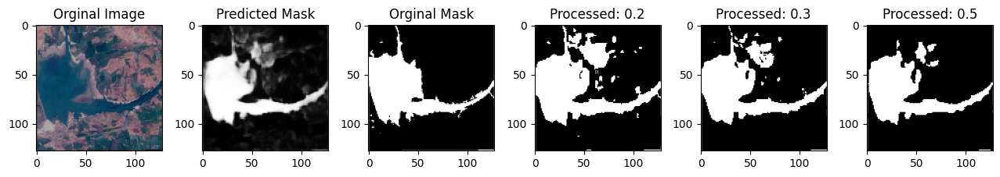

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7373 - loss: 0.2693 - val_accuracy: 0.7633 - val_loss: 0.2331
Epoch 80/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7421 - loss: 0.257


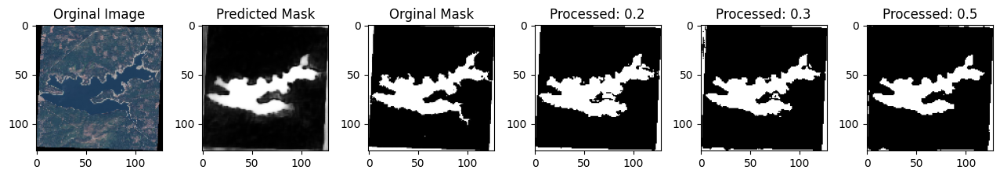

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7420 - loss: 0.2578 - val_accuracy: 0.7617 - val_loss: 0.2277
Epoch 81/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7411 - loss: 0.255


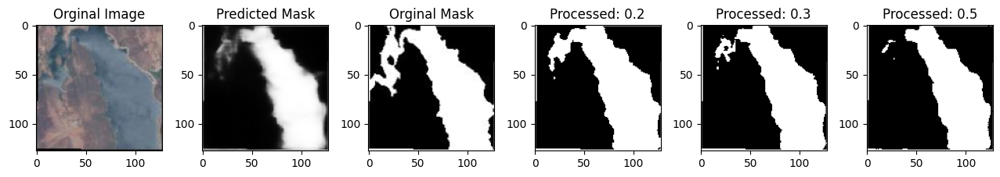

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7411 - loss: 0.2551 - val_accuracy: 0.7624 - val_loss: 0.2373
Epoch 82/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7416 - loss: 0.256


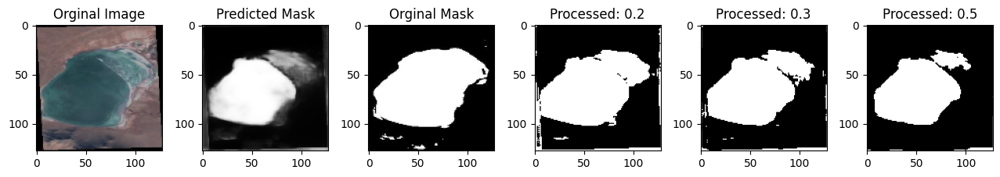

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7416 - loss: 0.2561 - val_accuracy: 0.7621 - val_loss: 0.2282
Epoch 83/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 12ms/stepep - accuracy: 0.7424 - loss: 0.253


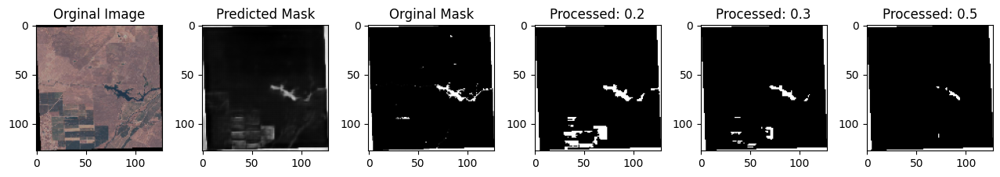

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7425 - loss: 0.2536 - val_accuracy: 0.7595 - val_loss: 0.2394
Epoch 84/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7457 - loss: 0.245


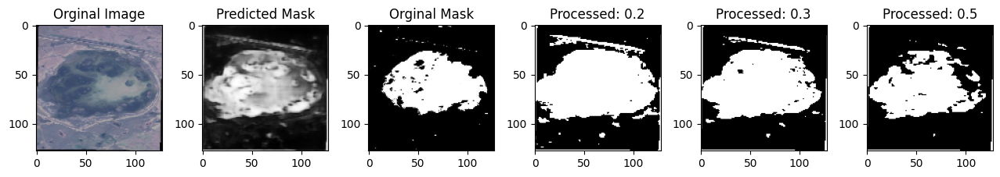

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 48ms/step - accuracy: 0.7457 - loss: 0.2454 - val_accuracy: 0.7619 - val_loss: 0.2301
Epoch 85/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7313 - loss: 0.26


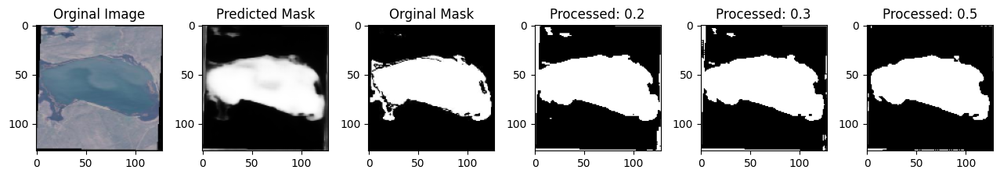

91/91 ━━━━━━━━━━━━━━━━━━━━ 5s 50ms/step - accuracy: 0.7315 - loss: 0.2612 - val_accuracy: 0.7657 - val_loss: 0.2220
Epoch 86/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7494 - loss: 0.247


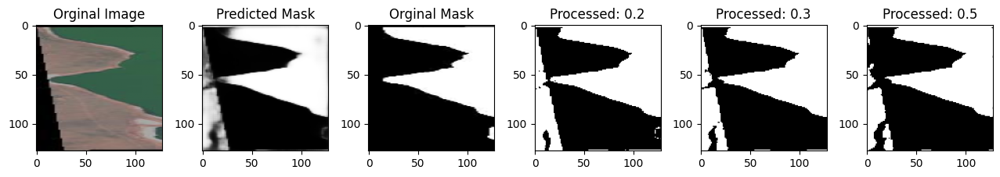

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7494 - loss: 0.2479 - val_accuracy: 0.7656 - val_loss: 0.2093
Epoch 87/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7461 - loss: 0.24


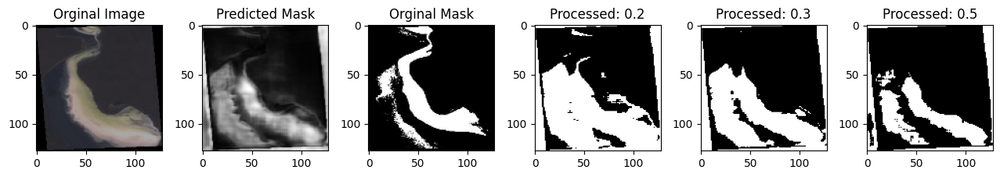

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7461 - loss: 0.2483 - val_accuracy: 0.7643 - val_loss: 0.2101
Epoch 88/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7432 - loss: 0.255


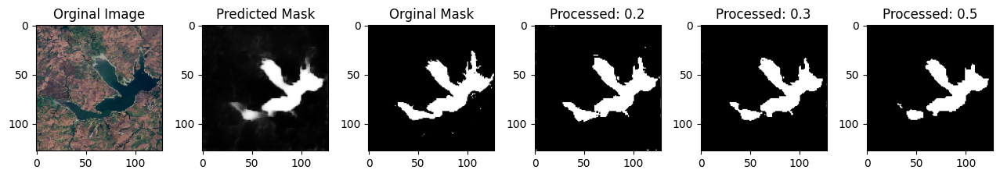

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 46ms/step - accuracy: 0.7432 - loss: 0.2557 - val_accuracy: 0.7559 - val_loss: 0.2342
Epoch 89/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7464 - loss: 0.238


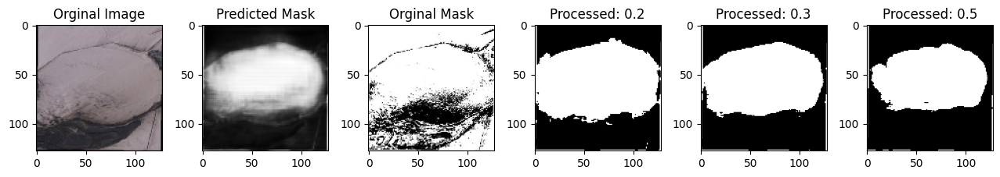

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7464 - loss: 0.2389 - val_accuracy: 0.7653 - val_loss: 0.2274
Epoch 90/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7221 - loss: 0.29


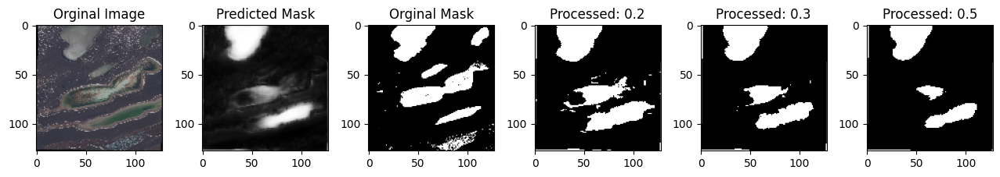

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7226 - loss: 0.2926 - val_accuracy: 0.7615 - val_loss: 0.2239
Epoch 91/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/steptep - accuracy: 0.7408 - loss: 0.24


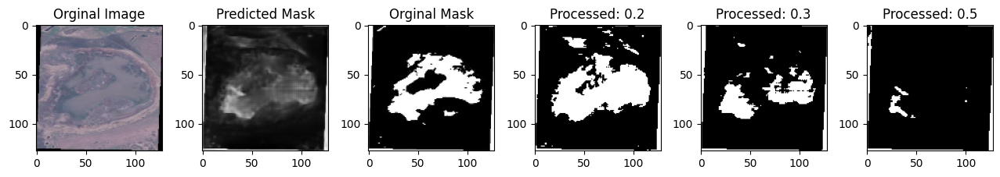

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7408 - loss: 0.2486 - val_accuracy: 0.7680 - val_loss: 0.2069
Epoch 92/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7477 - loss: 0.23


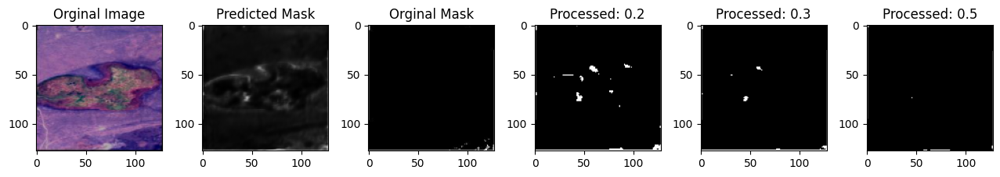

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7476 - loss: 0.2351 - val_accuracy: 0.7636 - val_loss: 0.2196
Epoch 93/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7429 - loss: 0.24


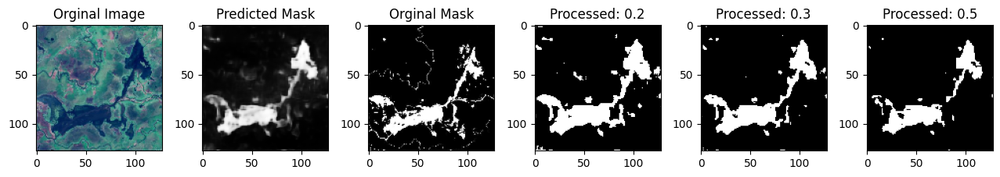

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 47ms/step - accuracy: 0.7429 - loss: 0.2407 - val_accuracy: 0.7648 - val_loss: 0.2214
Epoch 94/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7407 - loss: 0.24


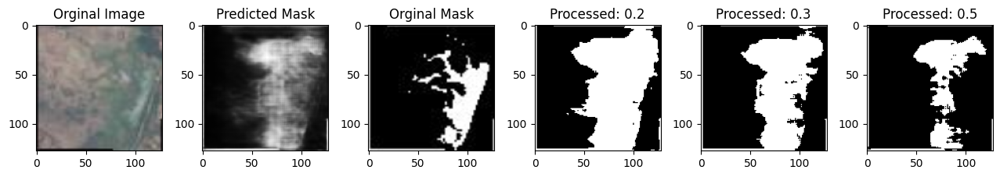

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7407 - loss: 0.2487 - val_accuracy: 0.7664 - val_loss: 0.2127
Epoch 95/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7442 - loss: 0.238


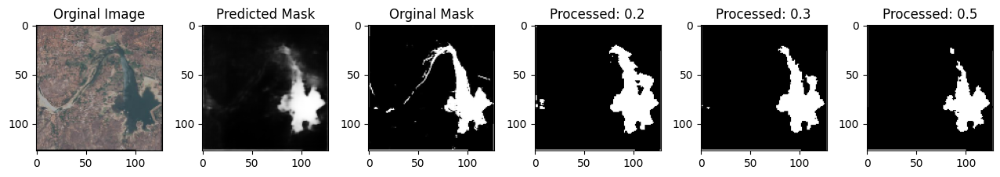

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7442 - loss: 0.2383 - val_accuracy: 0.7662 - val_loss: 0.2112
Epoch 96/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/stepep - accuracy: 0.7478 - loss: 0.237


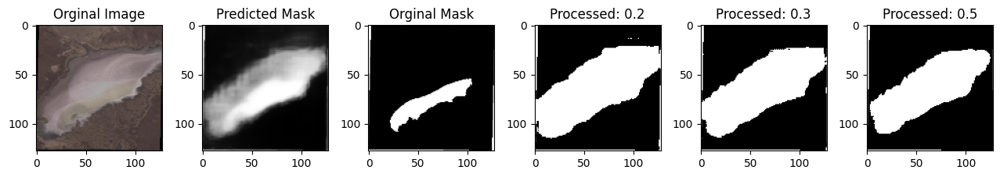

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7478 - loss: 0.2374 - val_accuracy: 0.7580 - val_loss: 0.2427
Epoch 97/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7314 - loss: 0.28


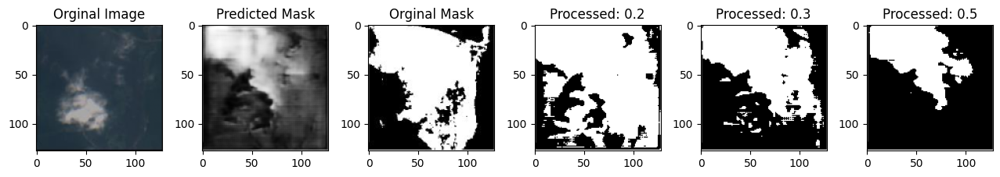

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7315 - loss: 0.2824 - val_accuracy: 0.7653 - val_loss: 0.2213
Epoch 98/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7377 - loss: 0.25


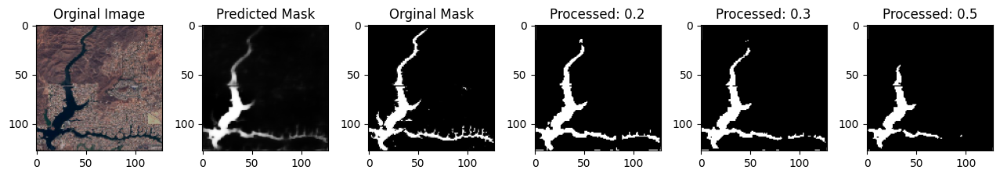

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7378 - loss: 0.2526 - val_accuracy: 0.7665 - val_loss: 0.2103
Epoch 99/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7507 - loss: 0.23


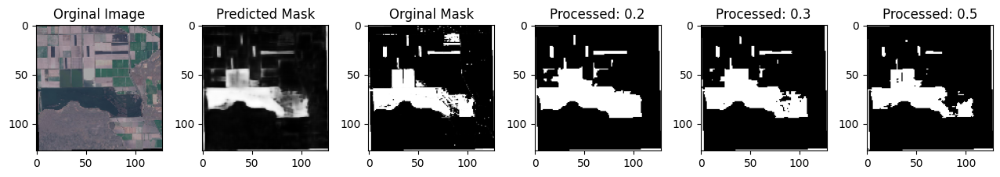

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7506 - loss: 0.2351 - val_accuracy: 0.7565 - val_loss: 0.2411
Epoch 100/100
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 10ms/stepep - accuracy: 0.7291 - loss: 0.285


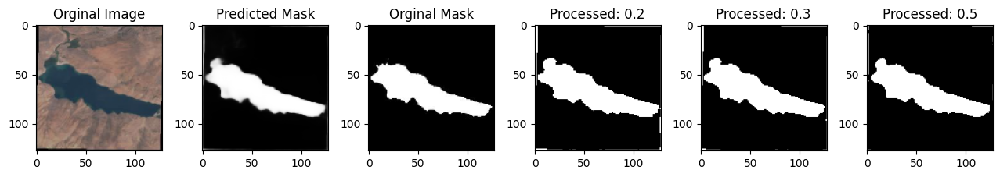

91/91 ━━━━━━━━━━━━━━━━━━━━ 4s 45ms/step - accuracy: 0.7293 - loss: 0.2851 - val_accuracy: 0.7646 - val_loss: 0.2215


In [22]:
# Training
epochs = 100
batch_size = 32

history = model.fit(images_train, mask_train,
                    validation_data=[images_test, mask_test], 
                    epochs=epochs,
                    callbacks=[ShowProgress()],
                    batch_size=batch_size)

In [25]:
from datetime import datetime

# Get the current date and time
current_time = datetime.now().strftime('%Y-%m-%d_%H-%M-%S')

# Save the model with the current date and time in the filename
model.save(f'models/{current_time}.keras')

OSError: [Errno 22] Invalid argument: 'models/2024-12-17T16:26:30.681494.keras'

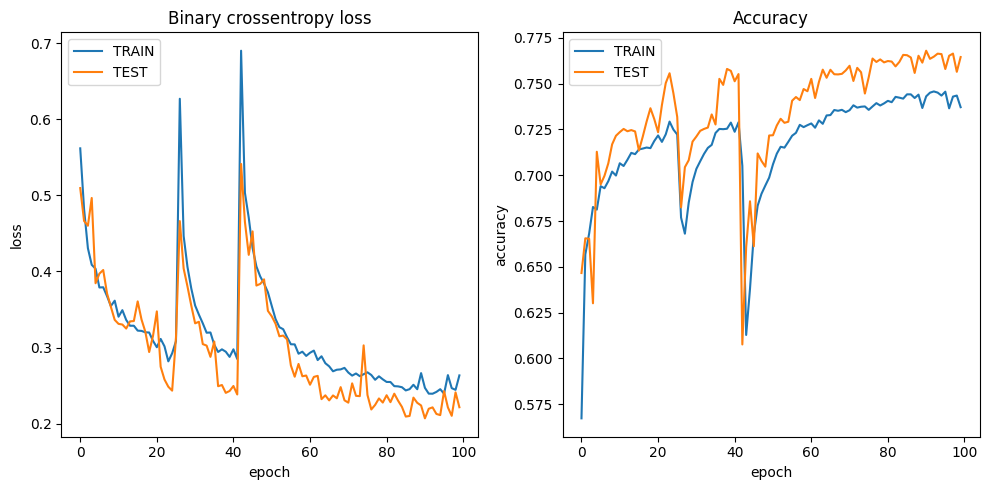

In [26]:
plt.figure(figsize=(10,5))

# Plot loss for each epoch
plt.subplot(1,2,1)
plt.plot(history.history['loss'], label="Train loss")
plt.plot(history.history['val_loss'], label="Test loss")
plt.title('Binary crossentropy loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['TRAIN', 'TEST'], loc='upper left')

# Plot accuracy for each epoch
plt.subplot(1,2,2)
plt.plot(history.history['accuracy'], label="Train accuracy")
plt.plot(history.history['val_accuracy'], label="Test accuracy")
plt.title('Accuracy')
plt.ylabel('accuracy')
plt.xlabel('epoch')
plt.legend(['TRAIN', 'TEST'], loc='upper left')

plt.tight_layout()
plt.show()

In [27]:
# Make predictions
predictions = model.predict(images_test)

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step


In [28]:
def plot_results(threshold=0.5):
    k = np.random.randint(len(images_test))
    original_image = images_test[k]
    mask = mask_test[k].reshape(128,128)
    predicted_mask = predictions[k].reshape(128,128)
    threshold_mask = mask_threshold(predicted_mask, threshold=threshold)

    plt.figure(figsize=(15,5))

    plt.subplot(1,4,1)
    plt.imshow(original_image);plt.title('Orginal Image')

    plt.subplot(1,4,2)
    plt.imshow(mask, cmap='gray');plt.title('Original Mask')

    plt.subplot(1,4,3)
    plt.imshow(predicted_mask, cmap='gray');plt.title('Predicted Mask')
    
    plt.subplot(1,4,4)
    plt.imshow(threshold_mask, cmap='gray');plt.title(f'Predicted Mask with cutoff={threshold}')

    plt.tight_layout()
    plt.show()

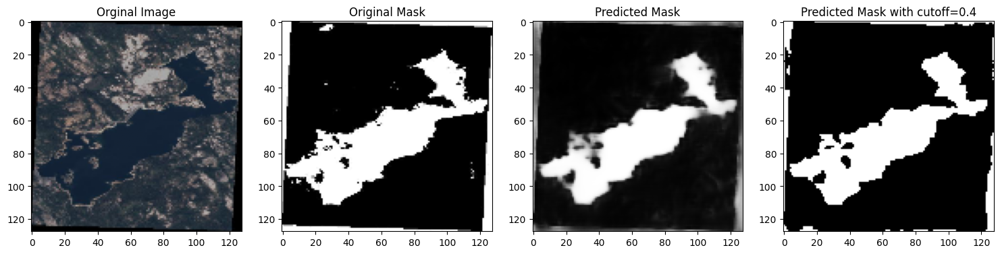

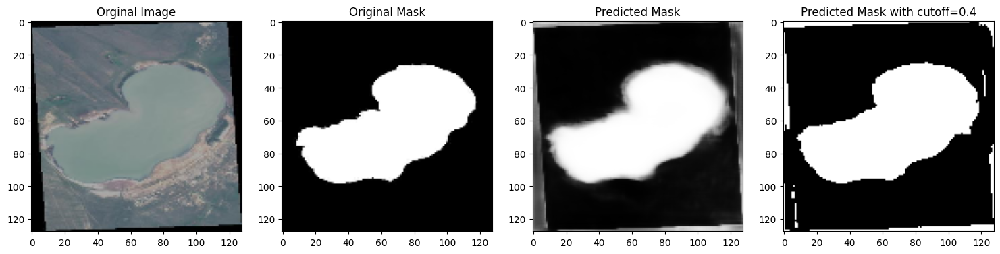

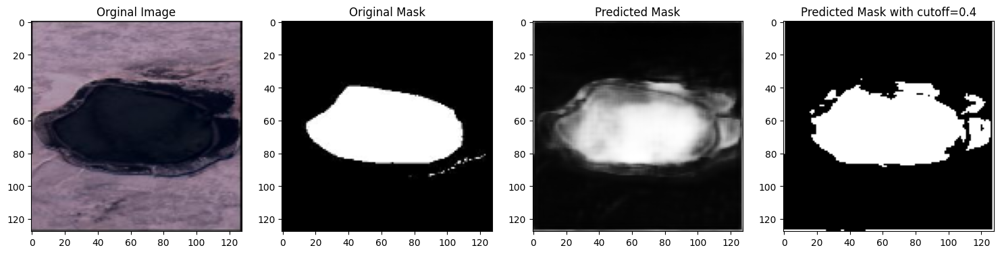

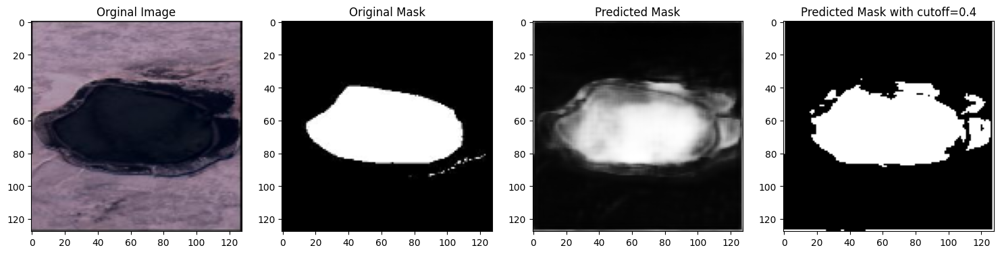

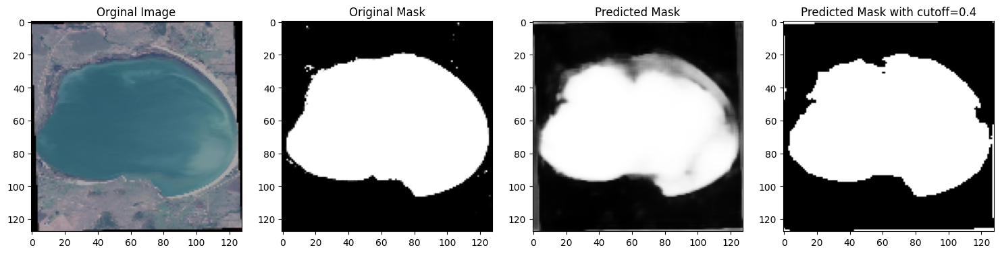

...

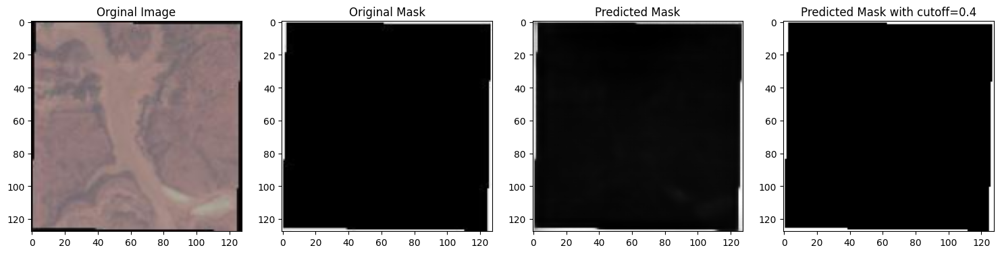

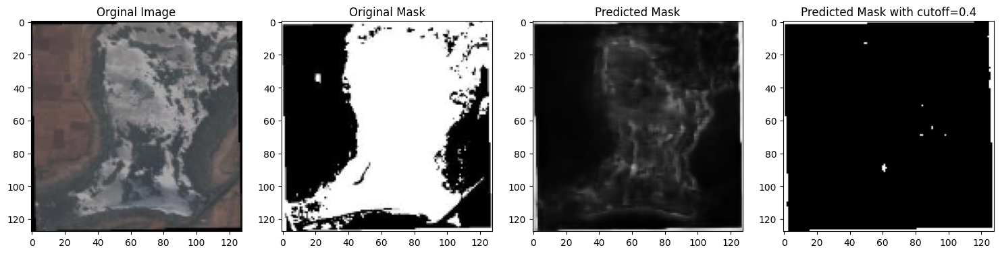

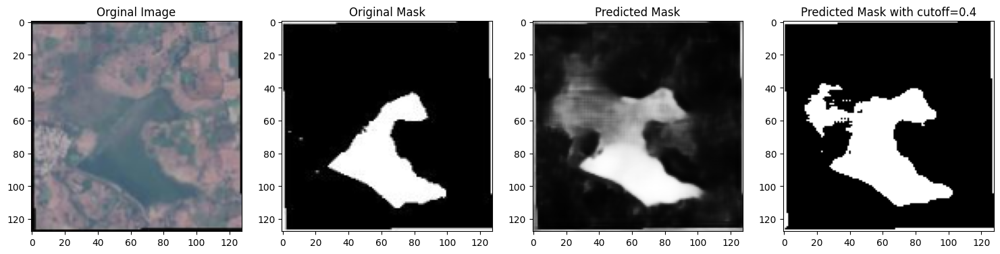

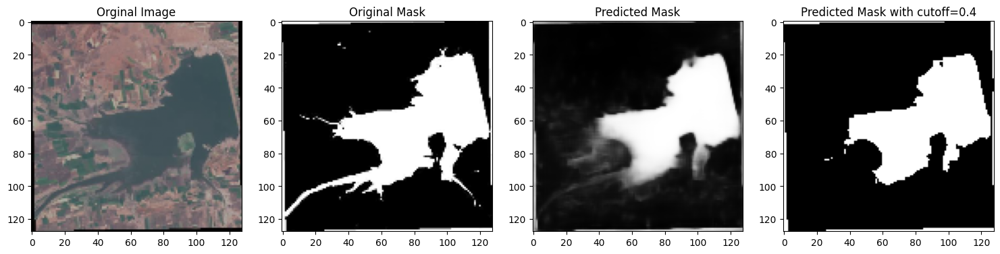

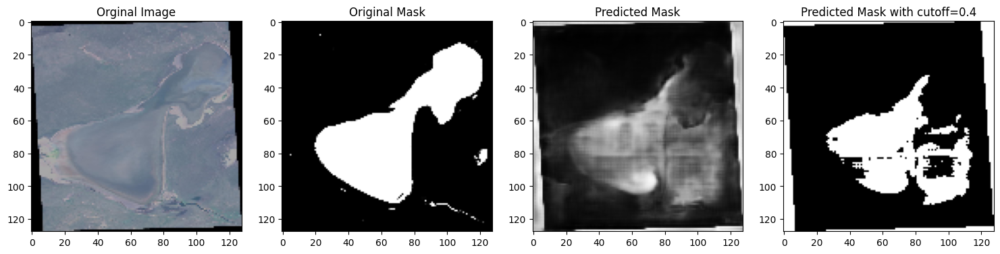

In [29]:
# Plot results on test data
for i in range(40):
  plot_results(threshold=0.4)